In [1]:
import time, glob, pickle
import numpy as np
import matplotlib.pyplot as plt
from astropy.io import fits
from sklearn.decomposition import PCA
from sklearn.impute import SimpleImputer

%matplotlib inline

In [2]:
def get_bot_filelist(raftnum,sensnum,runnum):
    tstart=time.time()
    basedir='/gpfs/slac/lsst/fs3/g/data/jobHarness/jh_stage/LCA-10134_Cryostat/LCA-10134_Cryostat-0001/'
    biassubdirs='BOT_acq/v0/*/*_bias*/'
    fitsname='*_'+raftnum+'_'+sensnum+'*.fits'

    lsfile=basedir+runnum+'/'+biassubdirs+fitsname
    filelist=np.sort(glob.glob(lsfile))
    return filelist

def get_not_detsec_xy(header):
    xmin,xmax,ymin,ymax=np.array(header['DATASEC'].strip('[').strip(']').replace(':',',').split(','),dtype=int)
    xs,ys=header['NAXIS1'],header['NAXIS2']
    prescanx,prescany=xmin-1,ymin-1
    overscanx,overscany=xs-prescanx-xmax-1,ys-prescany-ymax-1
    return prescanx,prescany,overscanx,overscany


In [3]:
raftnum,sensnum='R22','S22'
runnum='12693'#spots  #12781 B protocol v25, try 12741, 12729, 12693, 12692

filelist=get_bot_filelist(raftnum,sensnum,runnum)
print(len(filelist),'files \n',filelist[0],' ...\n',filelist[-1])

116 files 
 /gpfs/slac/lsst/fs3/g/data/jobHarness/jh_stage/LCA-10134_Cryostat/LCA-10134_Cryostat-0001/12693/BOT_acq/v0/101116/bias_bias_000/MC_C_20201108_000016_R22_S22.fits  ...
 /gpfs/slac/lsst/fs3/g/data/jobHarness/jh_stage/LCA-10134_Cryostat/LCA-10134_Cryostat-0001/12693/BOT_acq/v0/101118/flat_bias_177/MC_C_20201108_000195_R22_S22.fits


In [4]:
# get the overscan dimensions for the image (different for e2v/ITL)
px,py,ox,oy=get_not_detsec_xy(fits.getheader(filelist[0],1))
print(px,py,ox,oy)

10 0 43 45


In [5]:
#read in and stack up the amplifiers to get disk I/O done
iamp=4

ampstack=[]
tstart=time.time()
for i in range(len(filelist)):
    fooamp=fits.getdata(filelist[i],iamp+1).astype('float')
    ampstack.append(fooamp)
ampstack=np.array(ampstack)
print(np.shape(ampstack),", ",str(time.time()-tstart))

(116, 2048, 576) ,  17.65932011604309


In [6]:
meanamp=np.mean(ampstack,axis=0)

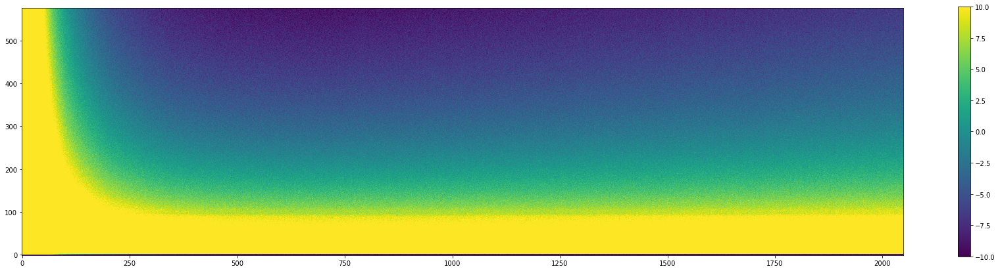

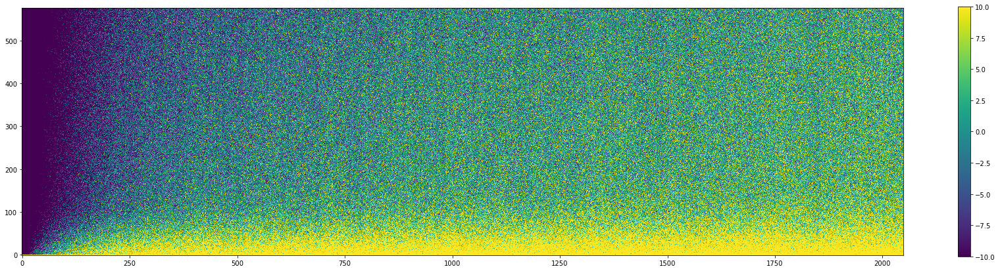

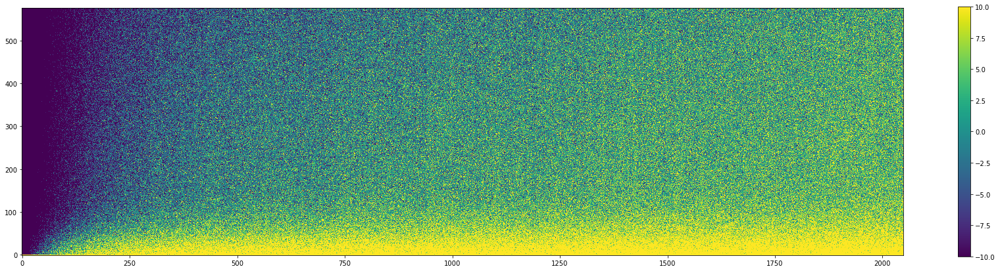

In [7]:
vmin,vmax=-10,10

fooarr=meanamp
plt.figure(figsize=(30,7))
plt.imshow((fooarr-fooarr.mean()).T,vmin=vmin,vmax=vmax,origin='lower')
plt.colorbar()

fooarr=ampstack[0]-meanamp
plt.figure(figsize=(30,7))
plt.imshow((fooarr-fooarr.mean()).T,vmin=vmin,vmax=vmax,origin='lower')
plt.colorbar()

fooarr=ampstack[-1]-meanamp
plt.figure(figsize=(30,7))
plt.imshow((fooarr-fooarr.mean()).T,vmin=vmin,vmax=vmax,origin='lower')
plt.colorbar()

In [8]:
std_max=10  # the max noise allowed on (amp minus master bias) to use for PCA training

In [9]:
# iterate through the stack, subtracting the master bias, and stacking X profiles to train
amps_profx,amps_profy=[],[]
xstart,ystart=2,0

tstart=time.time()
for i in np.arange(len(ampstack)):
    fooamp=ampstack[i].copy()
    fooamp-=meanamp
    fooamp-=np.mean(fooamp[-oy:,-ox:])
    if np.std(fooamp)>std_max: continue
    amps_profx.append(np.mean(fooamp,axis=0)[xstart:])
amps_profx=np.array(amps_profx)

print(time.time()-tstart,len(amps_profx),len(ampstack))

0.789905309677124 112 116


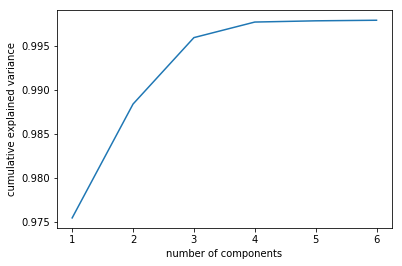

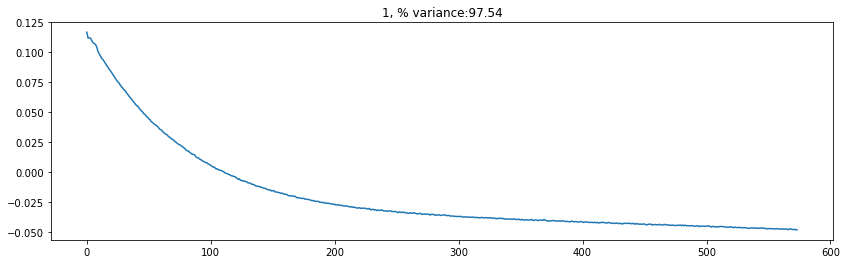

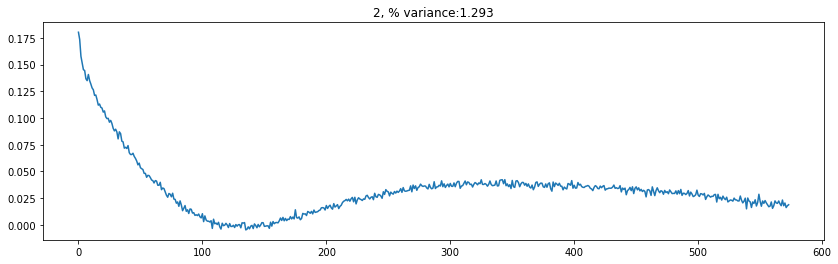

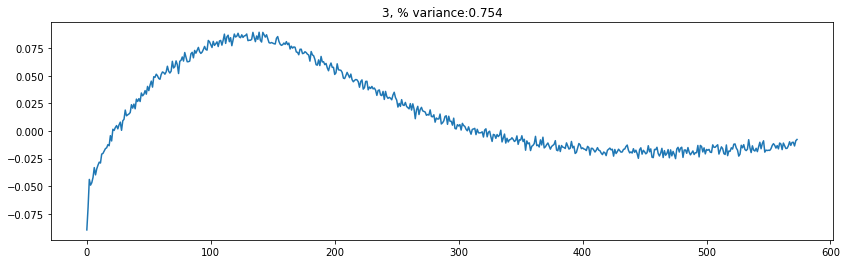

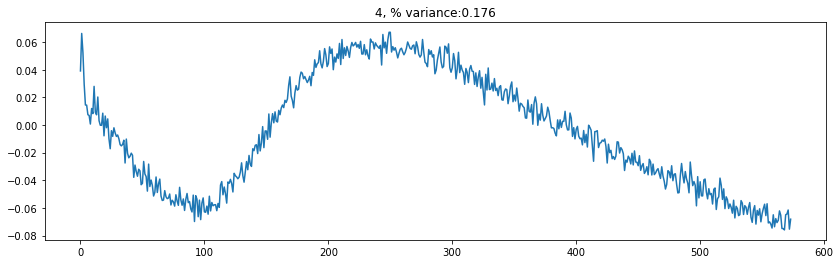

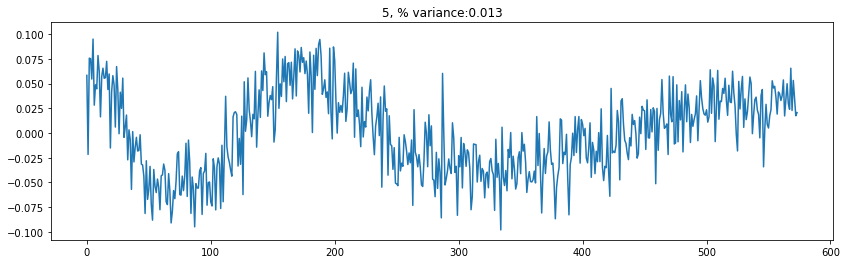

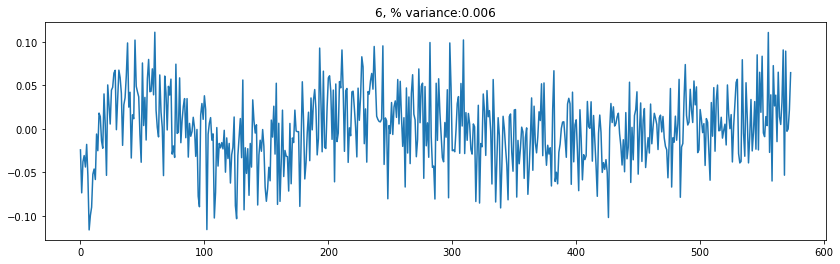

In [10]:
# fit the profiles in the serial direction
npcacompx=6

pcax = PCA(npcacompx)
pcax.fit(amps_profx)

plt.plot(np.arange(1,npcacompx+1),np.cumsum(pcax.explained_variance_ratio_))
plt.xlabel('number of components'),plt.ylabel('cumulative explained variance')

for i in range(npcacompx):
    plt.figure(figsize=(14,4)),plt.title(str(i+1)+', % variance:'+str(pcax.explained_variance_ratio_[i]*100)[:5])
    plt.plot(pcax.components_[i])

In [11]:
# now stack the (amp minus master bias) mean Y profiles for PCA training
# note: PCA in x direction subtracted 
# TODO: iterate back to X with Y subtracted, and then Y with new X subtracted?
amps_profx,amps_profy=[],[]

tstart=time.time()
for i in np.arange(len(ampstack)):
    fooamp=ampstack[i].copy()
    fooamp-=meanamp
    fooamp-=np.mean(fooamp[-oy:,-ox:])
    if np.std(fooamp)>std_max: continue
    compfoox=pcax.transform(fooamp[ystart:,xstart:])
    projfoox=pcax.inverse_transform(compfoox)
    ser_mod=np.mean(projfoox,axis=0)
    foosubx=fooamp[ystart:,xstart:]-ser_mod
    amps_profx.append(np.mean(foosubx,axis=0)[xstart:])
    amps_profy.append(np.mean(foosubx,axis=1)[ystart:])
amps_profy=np.array(amps_profy)

print(time.time()-tstart)


2.279237747192383


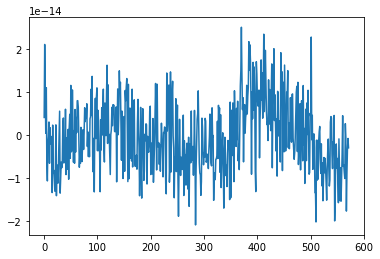

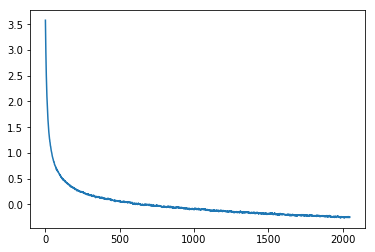

In [12]:
# look at the mean profile in X and Y...X should be consistent with zero
plt.plot(np.mean(amps_profx,axis=0))
plt.figure()
plt.plot(np.mean(amps_profy,axis=0))

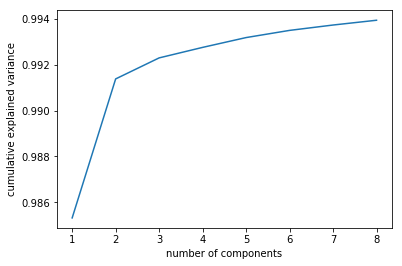

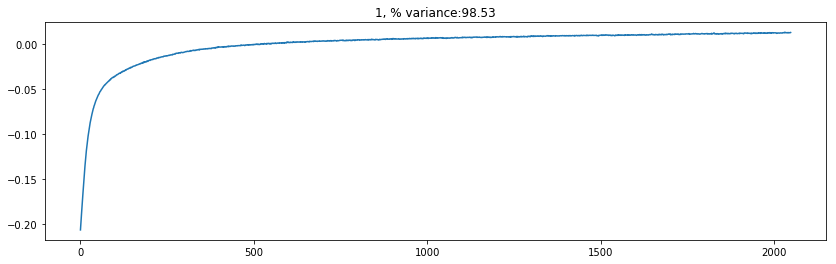

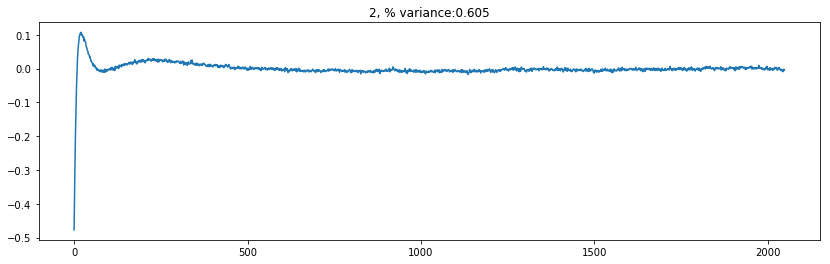

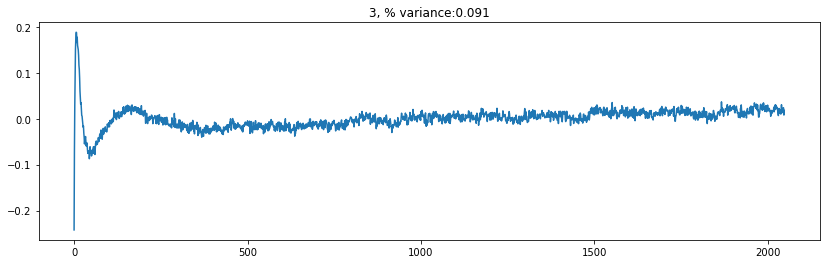

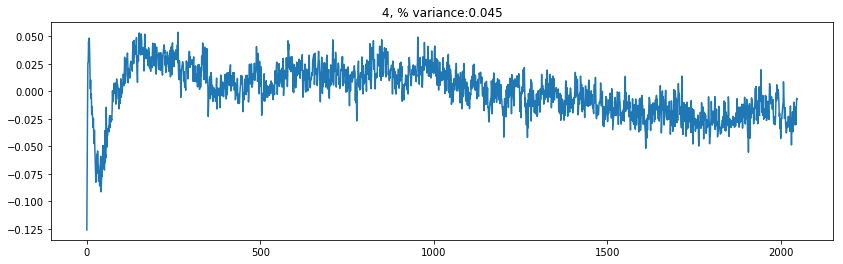

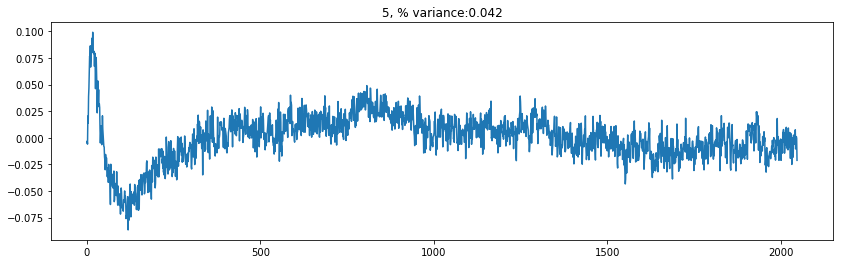

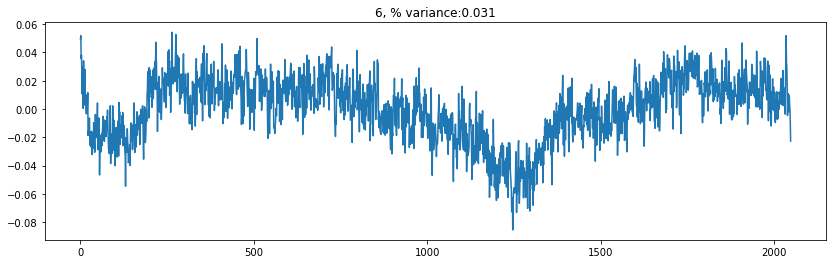

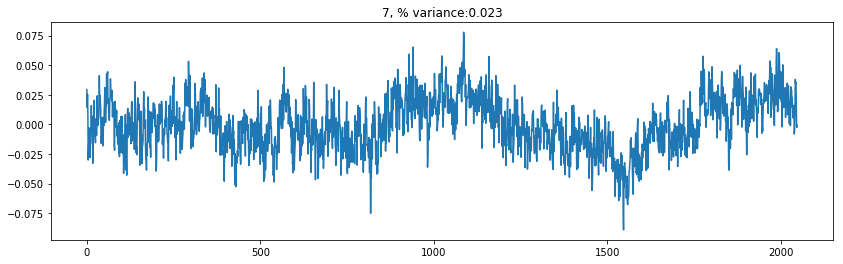

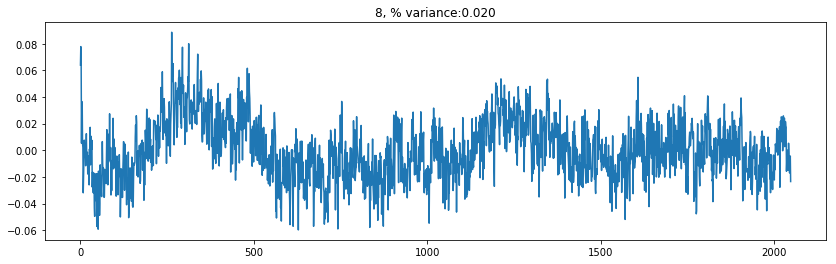

In [13]:
# train the PCA on the Y profiles
npcacompy=8
pcay = PCA(npcacompy)
pcay.fit(amps_profy)

plt.figure()
plt.plot(np.arange(1,npcacompy+1),np.cumsum(pcay.explained_variance_ratio_))
plt.xlabel('number of components'),plt.ylabel('cumulative explained variance')

for i in range(npcacompy):
    plt.figure(figsize=(14,4)),plt.title(str(i+1)+', % variance:'+str(pcay.explained_variance_ratio_[i]*100)[:5])
    plt.plot(pcay.components_[i])

0.9093978404998779


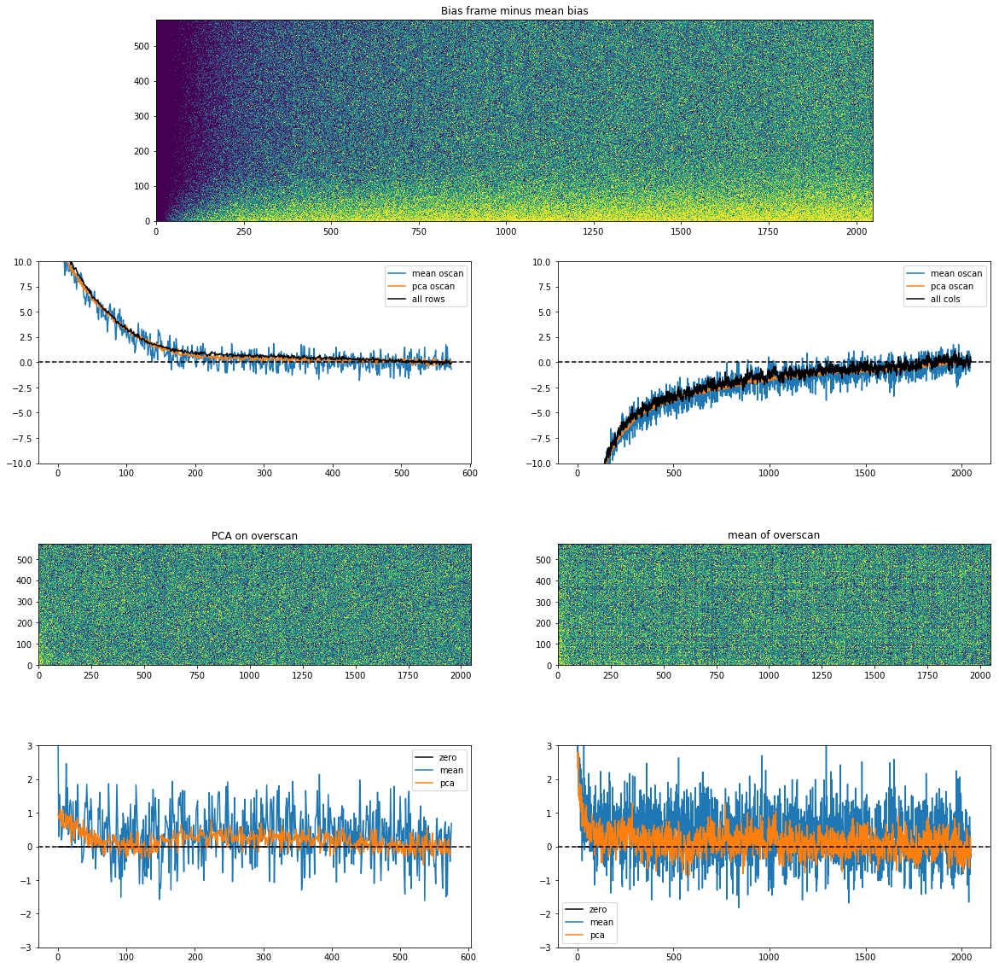

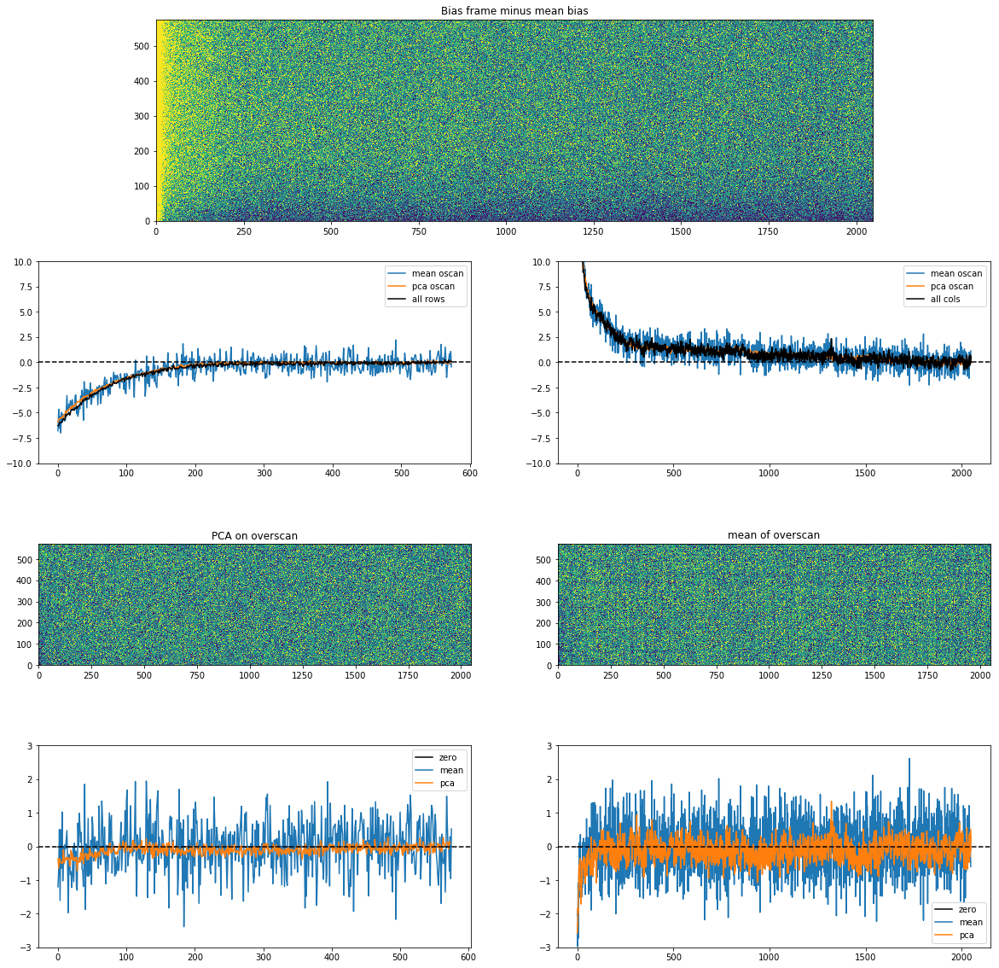

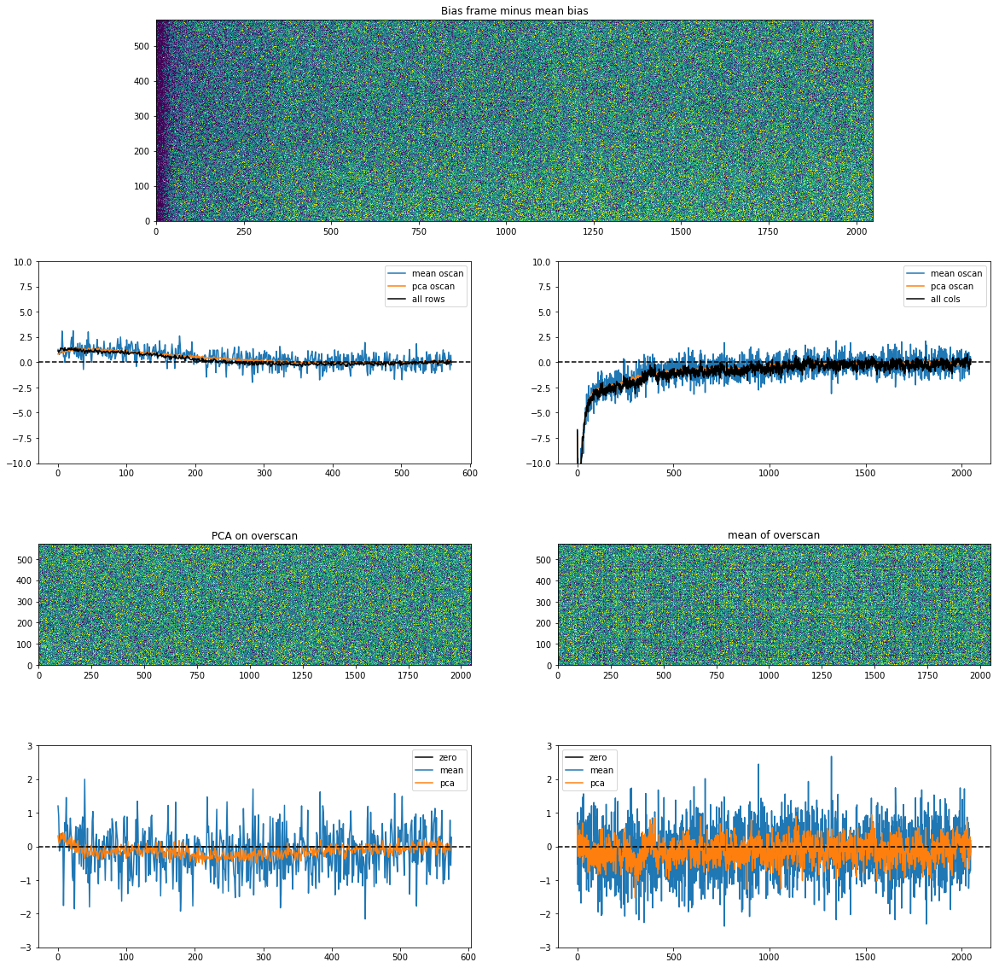

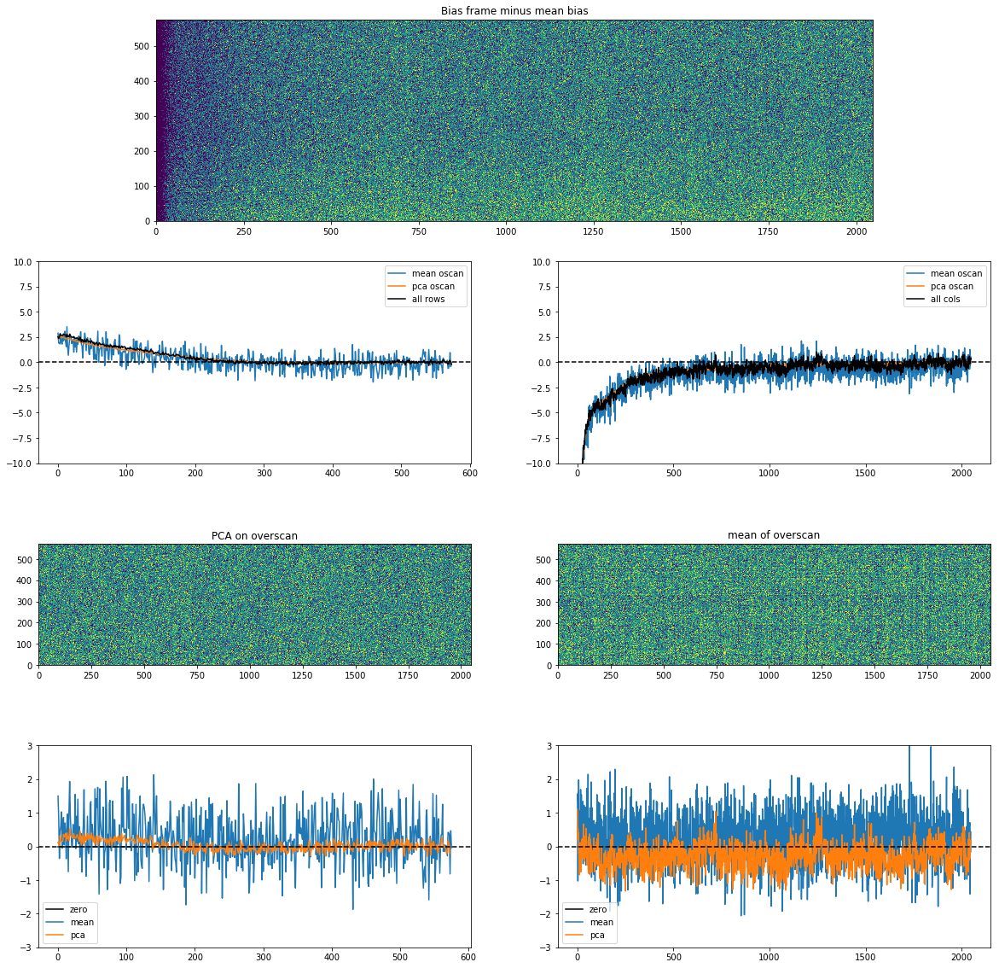

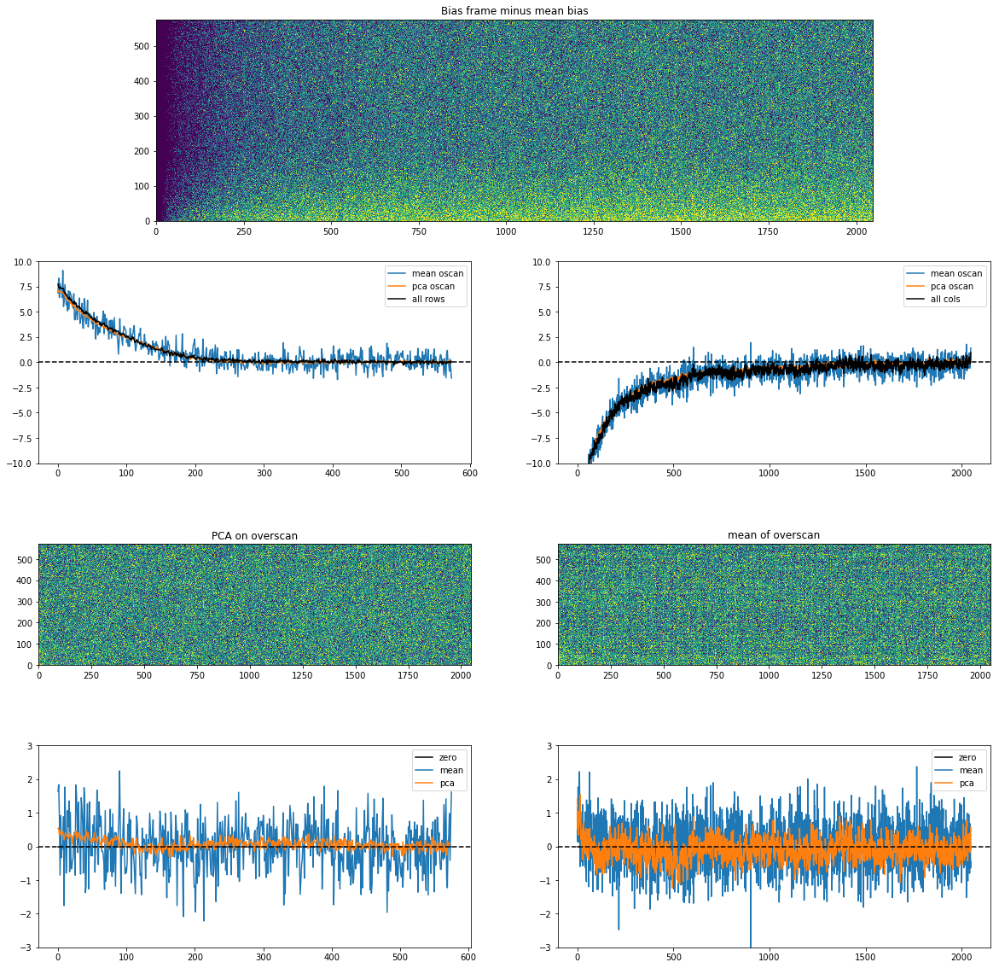

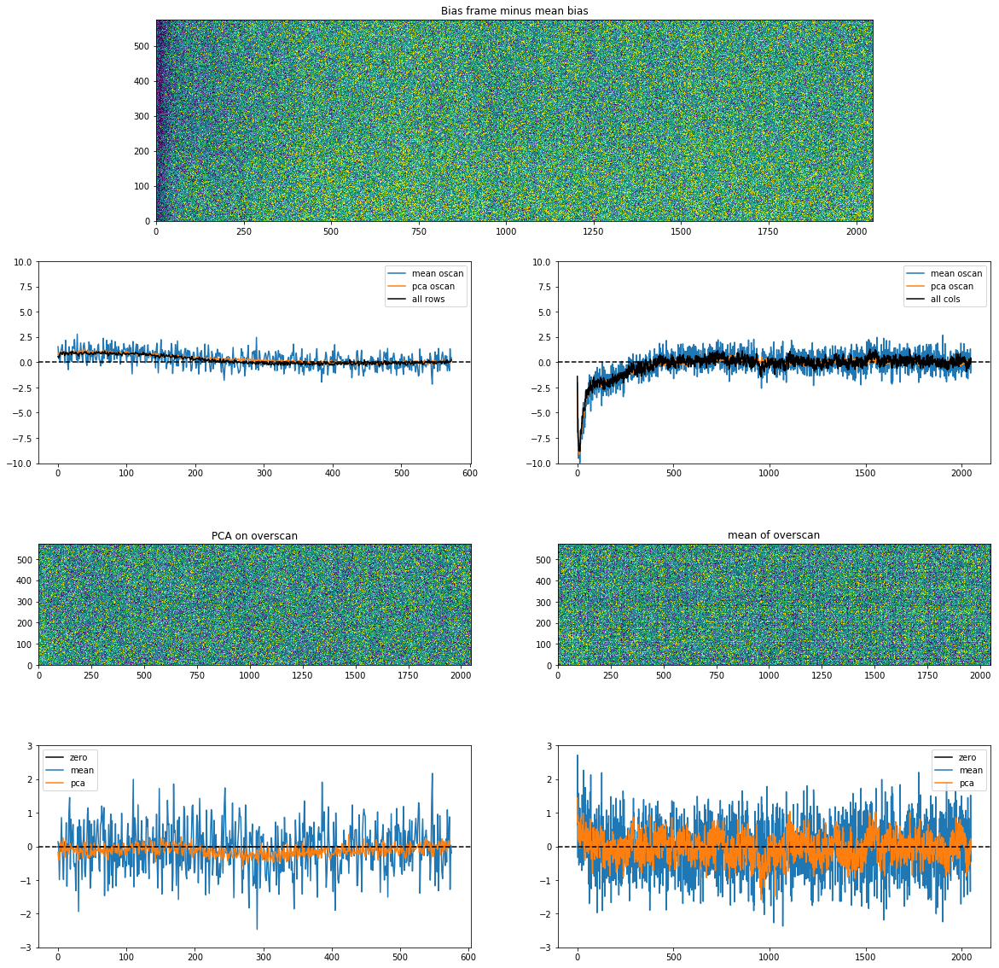

In [14]:
substack_pca=[]
substack_xyo=[]
tstart=time.time()
nstacks=0
for i in range(1,len(ampstack),20):
    fooarr=ampstack[i]-meanamp
    fooarr-=np.mean(fooarr[-oy:,-ox])
    if np.std(fooarr)>10: continue
    # make the serial model from Y overscan
    compfoox=pcax.transform(fooarr[-oy:,xstart:])
    projfoox=pcax.inverse_transform(compfoox)
    ser_mod=np.mean(projfoox,axis=0)
    
    #make the parallel profile from the X overscan (after subtracting serial model)
    foosubx=fooarr[ystart:,xstart:]-ser_mod
    compfooy=pcay.transform(foosubx[ystart:,-ox:].T)
    projfooy=pcay.inverse_transform(compfooy)
    par_mod=np.mean(projfooy,axis=0)
    
    # subtract the parallel profile from the X-subtracted amp, and save to stack
    foosub_pca=(foosubx.T-par_mod).T
    foosub_pca-=np.mean(foosub_pca[-oy:,-ox:])
    substack_pca.append(foosub_pca)
    
    # make the X/Y overscan subtracted biases for comparison
    xoscan=np.mean(fooarr[-oy:,:],axis=0)
    foosubx=fooarr-xoscan
    foosub_xyo=(foosubx.T-np.mean(foosubx[:,-ox:],axis=1)).T
    foosub_xyo-=np.mean(foosub_xyo[-oy:,-ox:])
    substack_xyo.append(foosub_xyo)

    nstacks+=1
    
    # plotting things for testing
    vmin,vmax=-10,10
    plt.figure(figsize=(20,20))
    plt.subplot(4,1,1)
    plt.imshow(fooarr.T,vmin=vmin,vmax=vmax,origin='lower'),plt.title('Bias frame minus mean bias')

    plt.subplot(4,2,3)
    profx=np.mean(fooarr,axis=0)[xstart:]
    profx_oscan=np.mean(fooarr[-oy:,:],axis=0)[xstart:]
    plt.plot(profx_oscan-np.mean(profx_oscan[-ox:]),label='mean oscan')
    plt.plot(ser_mod-np.mean(ser_mod[-ox:]),label='pca oscan')
    plt.plot(profx-np.mean(profx[-ox:]),label='all rows',color='k')
    plt.axhline(0,linestyle='--',color='k'),plt.legend(),plt.ylim(-10,10)

    plt.subplot(4,2,4)
    profy=np.mean(foosubx,axis=1)[ystart:]

    profy_oscan=np.mean(foosubx[:,-ox:],axis=1)[ystart:]
    plt.plot(profy_oscan-np.mean(profy_oscan[-oy:]),label='mean oscan')
    plt.plot(par_mod-np.mean(par_mod[-oy:]),label='pca oscan')
    plt.plot(profy-np.mean(profy[-oy:]),label='all cols',color='k')
    plt.axhline(0,linestyle='--',color='k'),plt.legend(),plt.ylim(-10,10)

    plt.subplot(4,2,5)
    plt.imshow((foosub_pca).T,vmin=vmin,vmax=vmax,origin='lower'),plt.title('PCA on overscan')
    plt.subplot(4,2,6)
    plt.imshow(foosub_xyo.T,vmin=vmin,vmax=vmax,origin='lower',interpolation=None),plt.title('mean of overscan')
    plt.subplot(4,2,7)
    plt.plot(np.mean(fooarr-np.mean(fooarr,axis=0),axis=0),label='zero',color='k')
    oscan_resid=np.mean(foosub_xyo,axis=0)
    plt.plot(oscan_resid-np.mean(oscan_resid[-ox:]),label='mean')
    pca_resid=np.mean(foosub_pca,axis=0)
    plt.plot(pca_resid-np.mean(pca_resid[-ox:]),label='pca')
    plt.axhline(0,linestyle='--',color='k'),plt.legend(),plt.ylim(-3,3)

    plt.subplot(4,2,8)
    plt.plot(np.mean(fooarr-np.mean(fooarr,axis=0),axis=0),label='zero',color='k')
    plt.plot(np.mean(foosub_xyo,axis=1),label='mean')
    plt.plot(np.mean(foosub_pca,axis=1),label='pca')
    plt.axhline(0,linestyle='--',color='k'),plt.legend(),plt.ylim(-3,3)
print(time.time()-tstart)

In [15]:
# now make the mean stack with all frames (same code as above, but no plotting)
substack_pca=[]
substack_xyo=[]
tstart=time.time()
nstacks=0
for i in range(len(ampstack)):
    fooarr=ampstack[i]-meanamp
    fooarr-=np.mean(fooarr[-oy:,-ox])
    if np.std(fooarr)>10: continue
    # make the serial model from Y overscan
    compfoox=pcax.transform(fooarr[-oy:,xstart:])
    projfoox=pcax.inverse_transform(compfoox)
    ser_mod=np.mean(projfoox,axis=0)
    
    #make the parallel profile from the X overscan (after subtracting serial model)
    foosubx=fooarr[ystart:,xstart:]-ser_mod
    compfooy=pcay.transform(foosubx[ystart:,-ox:].T)
    projfooy=pcay.inverse_transform(compfooy)
    par_mod=np.mean(projfooy,axis=0)
    
    # subtract the parallel profile from the X-subtracted amp, and save to stack
    foosub_pca=(foosubx.T-par_mod).T
    foosub_pca-=np.mean(foosub_pca[-oy:,-ox:])
    substack_pca.append(foosub_pca)
    
    # make the X/Y overscan subtracted biases for comparison
    xoscan=np.mean(fooarr[-oy:,:],axis=0)
    foosubx=fooarr-xoscan
    foosub_xyo=(foosubx.T-np.mean(foosubx[:,-ox:],axis=1)).T
    foosub_xyo-=np.mean(foosub_xyo[-oy:,-ox:])
    substack_xyo.append(foosub_xyo[ystart:,xstart:])

    nstacks+=1
    
substack_pca=np.array(substack_pca)
substack_xyo=np.array(substack_xyo)
print(time.time()-tstart)

3.113074541091919


In [16]:
# make the mean stack
mean_pca=np.mean(substack_pca,axis=0)
mean_xyo=np.mean(substack_xyo,axis=0)

# estimated range of the mean stack
adurange=np.std(ampstack[10]-meanamp)/np.sqrt(nstacks) # ~5 ADU /np.sqrt(nstacks),

(<matplotlib.image.AxesImage at 0x7f2868efdd10>,
 <matplotlib.colorbar.Colorbar at 0x7f2868ebcb50>)

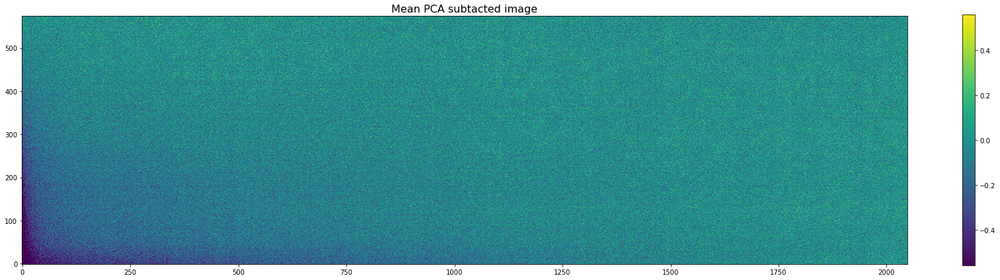

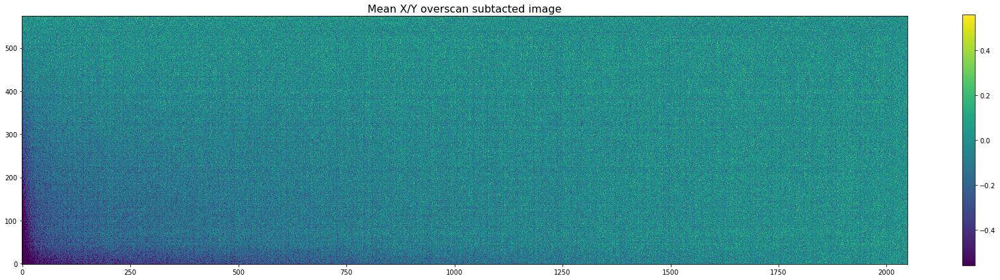

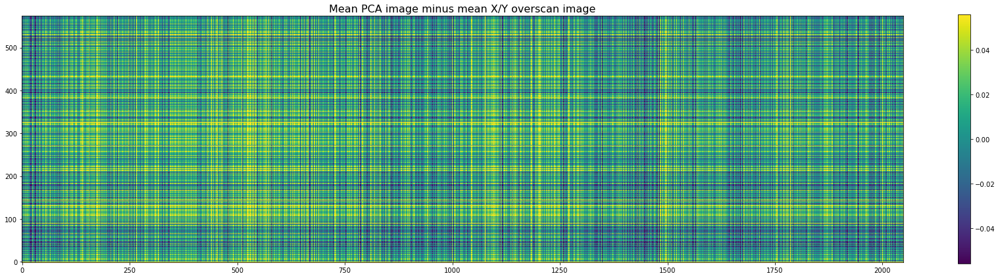

In [17]:
vmin,vmax=-adurange,adurange
plt.figure(figsize=(30,7)),plt.title('Mean PCA subtacted image',fontsize=16)
plt.imshow(mean_pca.T,vmin=vmin,vmax=vmax,origin='lower'),plt.colorbar()

plt.figure(figsize=(30,7)),plt.title('Mean X/Y overscan subtacted image',fontsize=16)
plt.imshow(mean_xyo.T,vmin=vmin,vmax=vmax,origin='lower'),plt.colorbar()

plt.figure(figsize=(30,7)),plt.title('Mean PCA image minus mean X/Y overscan image',fontsize=16)
plt.imshow((mean_pca-mean_xyo).T,vmin=vmin/10.,vmax=vmax/10.,origin='lower'),plt.colorbar()

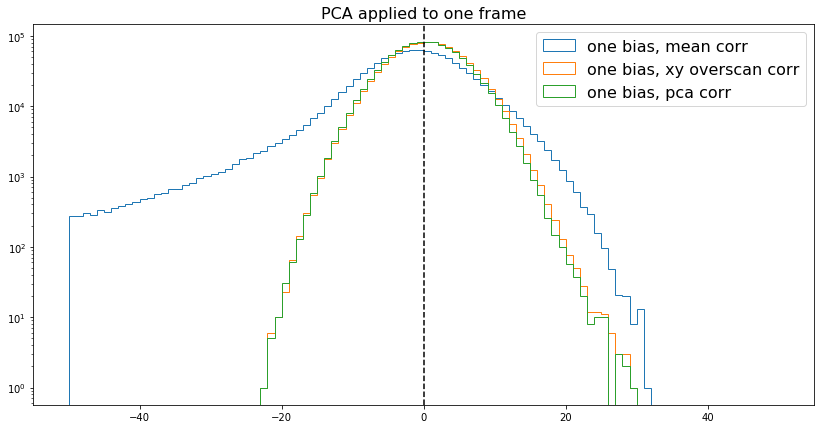

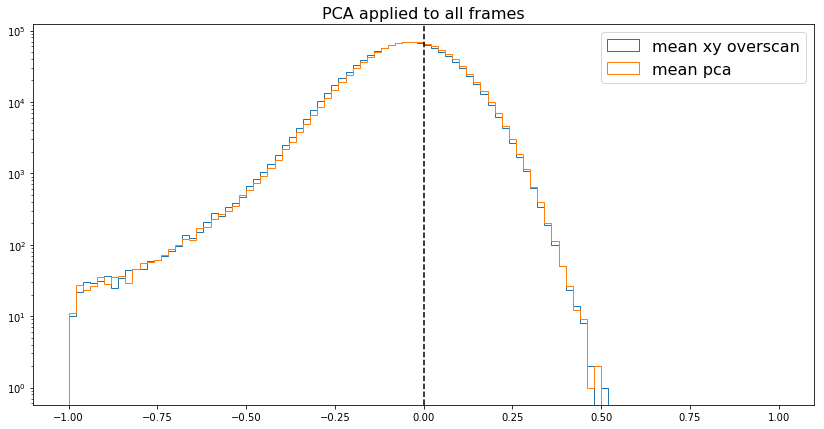

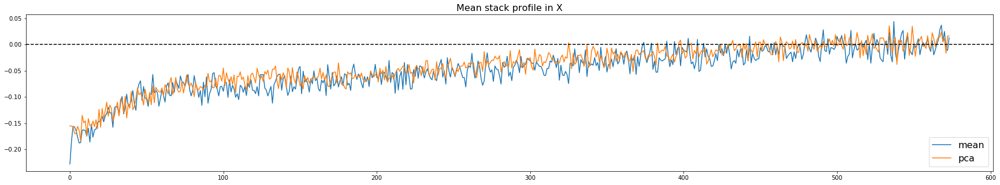

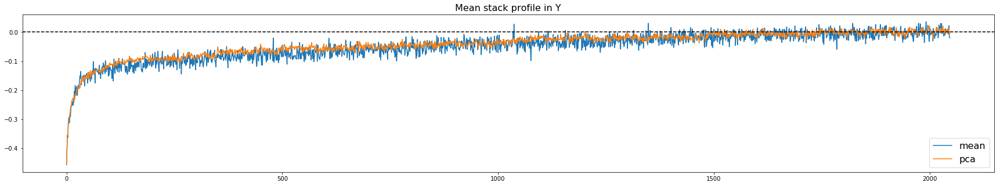

In [18]:
hmin,hmax=-50,50
nbins=100

# showing single frame PCA
plt.figure(figsize=(14,7)),plt.title('PCA applied to one frame',fontsize=16)
plt.hist((fooarr[py:-oy,px:-ox]).flatten(),bins=nbins,histtype='step',range=[hmin,hmax],label='one bias, mean corr')
plt.hist((foosub_xyo[py:-oy,px:-ox]).flatten(),bins=nbins,histtype='step',range=[hmin,hmax],label='one bias, xy overscan corr')
plt.hist((foosub_pca[py:-oy,px:-ox]).flatten(),bins=nbins,histtype='step',range=[hmin,hmax],label='one bias, pca corr')
plt.yscale('log')
plt.axvline(0,color='k',linestyle='--')
plt.legend(fontsize=16)

# showing the histogram of the mean stack
plt.figure(figsize=(14,7)),plt.title('PCA applied to all frames',fontsize=16)
hmin_stack,hmax_stack=-1,1
xmin,xmax,ymin,ymax=10,520,1000,2000
plt.hist(mean_xyo[py:-oy,px:-ox].flatten(),bins=nbins,histtype='step',range=[hmin_stack,hmax_stack],label='mean xy overscan')
plt.hist(mean_pca[py:-oy,px:-ox].flatten(),bins=nbins,histtype='step',range=[hmin_stack,hmax_stack],label='mean pca')
plt.axvline(0,color='k',linestyle='--')
plt.yscale('log')
plt.legend(fontsize=16)


# show the X and Y profiles of the mean stack
plt.figure(figsize=(30,5)),plt.title('Mean stack profile in X',fontsize=16)
plt.plot(np.mean(mean_xyo,axis=0),label='mean')
plt.plot(np.mean(mean_pca,axis=0),label='pca')
plt.axhline(0,color='k',linestyle='--')
plt.legend(fontsize=16)


plt.figure(figsize=(30,5)),plt.title('Mean stack profile in Y',fontsize=16)
plt.plot(np.mean(mean_xyo,axis=1),label='mean')
plt.plot(np.mean(mean_pca,axis=1),label='pca')
plt.axhline(0,color='k',linestyle='--')
plt.legend(fontsize=16)


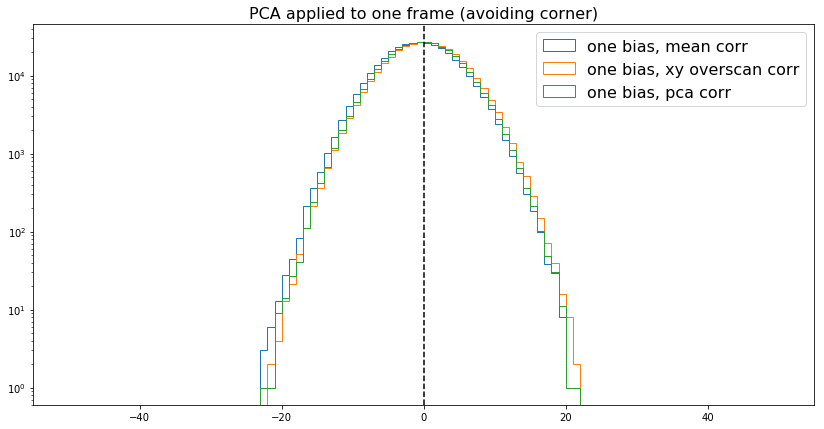

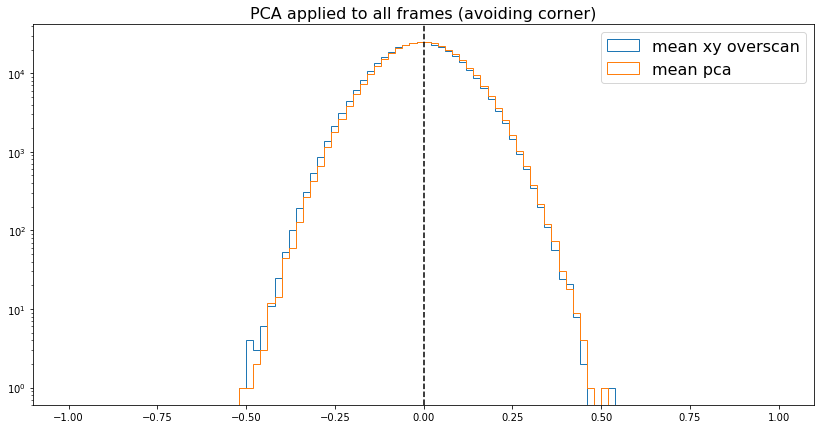

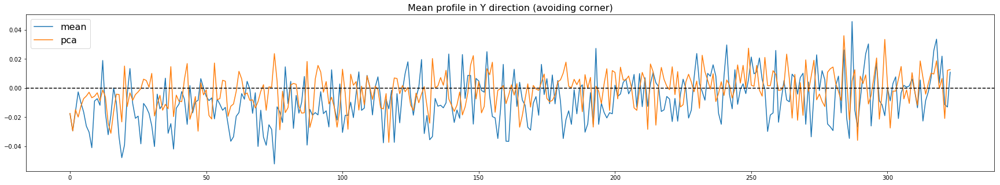

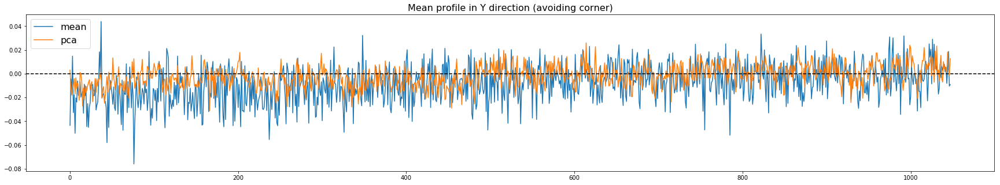

In [19]:
hmin,hmax=-50,50
nbins=100

# showing single frame PCA
plt.figure(figsize=(14,7)),plt.title('PCA applied to one frame (avoiding corner)',fontsize=16)
plt.hist((fooarr[1000:,250:]).flatten(),bins=nbins,histtype='step',range=[hmin,hmax],label='one bias, mean corr')
plt.hist((foosub_xyo[1000:,250:]).flatten(),bins=nbins,histtype='step',range=[hmin,hmax],label='one bias, xy overscan corr')
plt.hist((foosub_pca[1000:,250:]).flatten(),bins=nbins,histtype='step',range=[hmin,hmax],label='one bias, pca corr')
plt.yscale('log')
plt.axvline(0,color='k',linestyle='--')
plt.legend(fontsize=16)

# showing the histogram of the mean stack
plt.figure(figsize=(14,7)),plt.title('PCA applied to all frames (avoiding corner)',fontsize=16)
hmin_stack,hmax_stack=-1,1
xmin,xmax,ymin,ymax=10,520,1000,2000
plt.hist(mean_xyo[1000:,250:].flatten(),bins=nbins,histtype='step',range=[hmin_stack,hmax_stack],label='mean xy overscan')
plt.hist(mean_pca[1000:,250:].flatten(),bins=nbins,histtype='step',range=[hmin_stack,hmax_stack],label='mean pca')
plt.axvline(0,color='k',linestyle='--')
plt.yscale('log')
plt.legend(fontsize=16)

plt.figure(figsize=(30,5)),plt.title('Mean profile in Y direction (avoiding corner)',fontsize=16)
plt.plot(np.mean(mean_xyo[1000:,250:],axis=0),label='mean')
plt.plot(np.mean(mean_pca[1000:,250:],axis=0),label='pca')
#plt.plot(np.mean(mean_pca_xyo,axis=0),label='pca+mean')
plt.axhline(0,color='k',linestyle='--')
plt.legend(fontsize=16)


plt.figure(figsize=(30,5)),plt.title('Mean profile in Y direction (avoiding corner)',fontsize=16)
plt.plot(np.mean(mean_xyo[1000:,250:],axis=1),label='mean')
plt.plot(np.mean(mean_pca[1000:,250:],axis=1),label='pca')
#plt.plot(np.mean(mean_pca_xyo,axis=1),label='pca+mean')
#plt.plot(np.mean(mean_pca_xyo,axis=1),label='pca+mean')
plt.axhline(0,color='k',linestyle='--')
plt.legend(fontsize=16)
